This step focuses on EDA analysis for the data. The goal of the EDA work is to
get familiar with the features in out dataset, investigate the relationships between
features, and generally understand the core characteristics of the dataset. 

**Cleaning, transforming, and visualizing**

Visualizing correlations

_Importing libraries_

In [1]:
import os
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt 
import seaborn as sns # For all our visualization needs.
import statsmodels.api as sm # What does this do? Find out and type here. A convenience interface for specifying models using formula strings and DataFrames. 
from statsmodels.graphics.api import abline_plot # What does this do? Find out and type here. 
from sklearn.metrics import mean_squared_error, r2_score # What does this do? Find out and type here.
from sklearn.model_selection import train_test_split #  What does this do? Find out and type here.
from sklearn import linear_model, preprocessing # What does this do? Find out and type here.
import warnings # For handling error messages.
# Don't worry about the following two instructions: they just suppress warnings that could occur later. 
warnings.simplefilter(action="ignore", category=FutureWarning)
warnings.filterwarnings(action="ignore", module="scipy", message="^internal gelsd")

_Loading Appliances Energy Usage Data_

In [2]:
appliances_data = pd.read_csv('C:/Users/msale/Documents/Springboard Data Science Track_Jan 2022/Springboard-Capstone-Two/raw_data/energydata.csv')

_Data Science Problem_

The purpose of this data science project is to come up with a model to predict the applainces energy usage based on consumner's house temperature and humidity conditions plus outside enviromental conditions 

In [3]:
appliances_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19735 entries, 0 to 19734
Data columns (total 29 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   date         19735 non-null  object 
 1   Appliances   19735 non-null  int64  
 2   lights       19735 non-null  int64  
 3   T1           19735 non-null  float64
 4   RH_1         19735 non-null  float64
 5   T2           19735 non-null  float64
 6   RH_2         19735 non-null  float64
 7   T3           19735 non-null  float64
 8   RH_3         19735 non-null  float64
 9   T4           19735 non-null  float64
 10  RH_4         19735 non-null  float64
 11  T5           19735 non-null  float64
 12  RH_5         19735 non-null  float64
 13  T6           19735 non-null  float64
 14  RH_6         19735 non-null  float64
 15  T7           19735 non-null  float64
 16  RH_7         19735 non-null  float64
 17  T8           19735 non-null  float64
 18  RH_8         19735 non-null  float64
 19  T9  

In [4]:
appliances_data.head()

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,...,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,...,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,...,17.000000,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1,28.642668,28.642668
3,2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,...,17.000000,45.40,6.250000,733.8,92.0,6.000000,51.500000,5.0,45.410389,45.410389
4,2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,...,17.000000,45.40,6.133333,733.9,92.0,5.666667,47.666667,4.9,10.084097,10.084097


In [5]:
appliances_data.isnull().values.any()

False

_This is a data set with no missing data_ :)

_Rename columns for more readability_

In [6]:
appliances_data= appliances_data.rename(index=str, columns={"Appliances":"Appliances_E_Wh", "lights": "Lights_E_Wh","T1":"T_Kitchen", "RH_1":"H_Kitchen", "T2":"T_Living", "RH_2":"H_Living", "T3":"T_Laundry", "RH_3":"H_Laundry", "T4":"T_Office", "RH_4":"H_Office", "T5":"T_Bathroom", "RH_5":"H_Bathroom", "T6":"T_Building_out_NS", "RH_6":"H_Building_out_NS",
"T7":"T_Ironning", "RH_7":"H_Ironing", "T8":"T_Teenager", "RH_8":"H_Teenager", "T9":"T_Parents", "RH_9":"H_Parents", "Press_mm_hg": "Press_out", "RH_out":"H_out", "rv1":"RV_1", "rv2": "RV_2"})

In [7]:
appliances_data.head()

,date,Appliances_E_Wh,Lights_E_Wh,T_Kitchen,H_Kitchen,T_Living,H_Living,T_Laundry,H_Laundry,T_Office,...,T_Parents,H_Parents,T_out,Press_out,H_out,Windspeed,Visibility,Tdewpoint,RV_1,RV_2
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,...,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,...,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,...,17.000000,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1,28.642668,28.642668
3,2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,...,17.000000,45.40,6.250000,733.8,92.0,6.000000,51.500000,5.0,45.410389,45.410389
4,2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,...,17.000000,45.40,6.133333,733.9,92.0,5.666667,47.666667,4.9,10.084097,10.084097


In [8]:
appliances_data.describe().T

,count,mean,std,min,25%,50%,75%,max
Appliances_E_Wh,19735.0,97.694958,102.524891,10.000000,50.000000,60.000000,100.000000,1080.000000
Lights_E_Wh,19735.0,3.801875,7.935988,0.000000,0.000000,0.000000,0.000000,70.000000
T_Kitchen,19735.0,21.686571,1.606066,16.790000,20.760000,21.600000,22.600000,26.260000
H_Kitchen,19735.0,40.259739,3.979299,27.023333,37.333333,39.656667,43.066667,63.360000
T_Living,19735.0,20.341219,2.192974,16.100000,18.790000,20.000000,21.500000,29.856667
H_Living,19735.0,40.420420,4.069813,20.463333,37.900000,40.500000,43.260000,56.026667
T_Laundry,19735.0,22.267611,2.006111,17.200000,20.790000,22.100000,23.290000,29.236000
H_Laundry,19735.0,39.242500,3.254576,28.766667,36.900000,38.530000,41.760000,50.163333
T_Office,19735.0,20.855335,2.042884,15.100000,19.530000,20.666667,22.100000,26.200000
H_Office,19735.0,39.026904,4.341321,27.660000,35.530000,38.400000,42.156667,51.090000


_Appliances_E_Wh_ std is higehr than mean value! same is true for _Lights_E_Wh_ and additionally 25, 50, and 75% quartiles are 0! These seems to be abnormal distributions.  

In [9]:
df = appliances_data

In [10]:
df['Appliances_E_Wh'].describe()

count    19735.000000
mean        97.694958
std        102.524891
min         10.000000
25%         50.000000
50%         60.000000
75%        100.000000
max       1080.000000
Name: Appliances_E_Wh, dtype: float64

In [11]:
df['Appliances_E_Wh'].value_counts()

50      4368
60      3282
40      2019
70      1560
80      1205
        ... 
890        1
1070       1
910        1
1080       1
840        1
Name: Appliances_E_Wh, Length: 92, dtype: int64

In [12]:
df['Lights_E_Wh'].describe()

count    19735.000000
mean         3.801875
std          7.935988
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max         70.000000
Name: Lights_E_Wh, dtype: float64

In [31]:
df['Lights_E_Wh'].value_counts()

0     15252
10     2212
20     1624
30      559
40       77
50        9
70        1
60        1
Name: Lights_E_Wh, dtype: int64

_Generating histograms of the numeric columns_

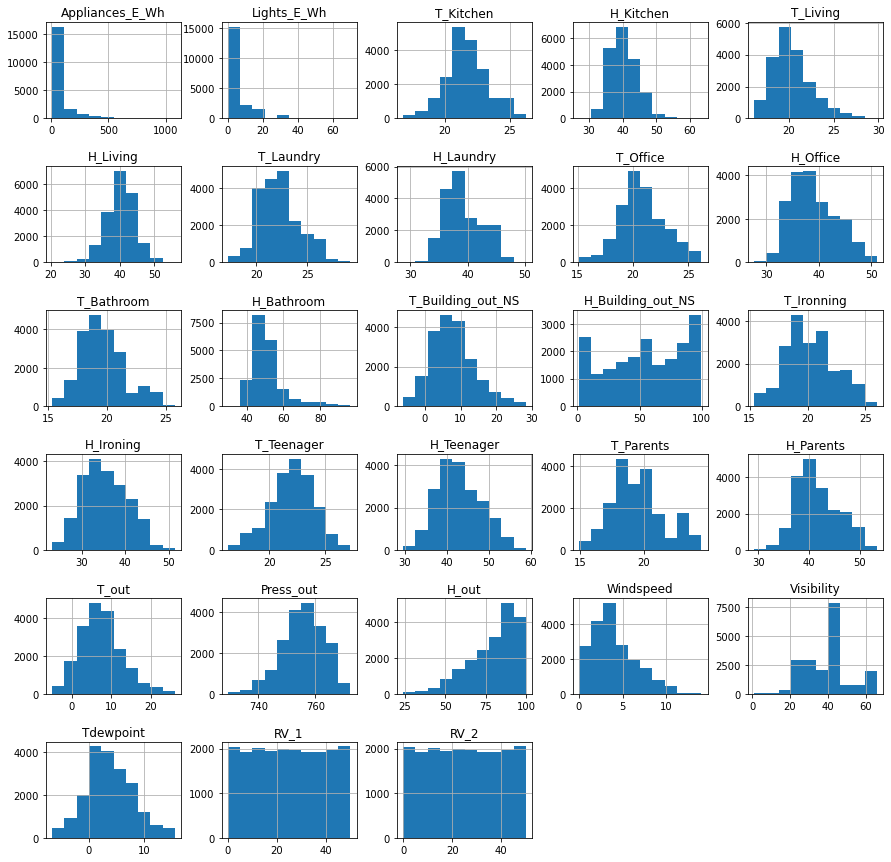

In [13]:
df.hist(figsize=(15,15))
plt.subplots_adjust(hspace=0.5);

_Appliances_E_Wh & Lights_E_Wh_ are heavily skewed to the left. _H_Building_out_NS_ has a strange distribution and that for _H_out_ is skewed to the right. _Visibility_ also looks abnormal. 

In [35]:
df= df.drop(["RV_1", "RV_2"],axis=1)  # dropping two random variables 

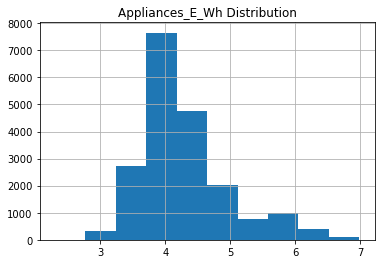

In [36]:
np.log(df['Appliances_E_Wh']).hist()  # log transform makes the hist plot more appealing 
plt.title("Appliances_E_Wh Distribution")
plt.subplots_adjust(hspace=0.5);

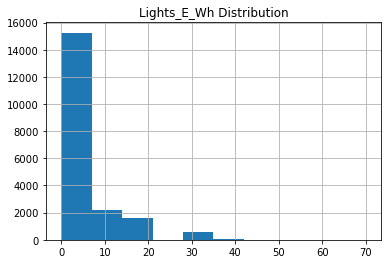

In [37]:
df['Lights_E_Wh'].hist()
plt.title("Lights_E_Wh Distribution")
plt.subplots_adjust(hspace=0.5);

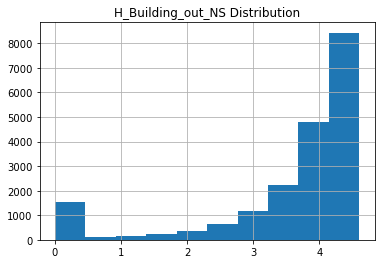

In [38]:
np.log(df['H_Building_out_NS']).hist()
plt.title("H_Building_out_NS Distribution")
plt.subplots_adjust(hspace=0.5);

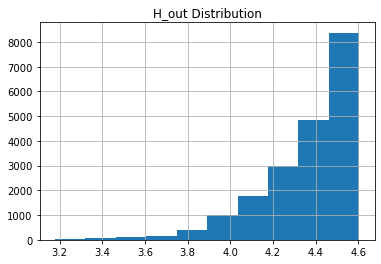

In [39]:
np.log(df['H_out']).hist();
plt.title("H_out Distribution");

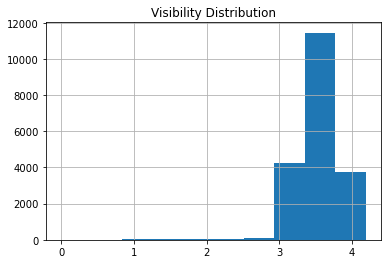

In [40]:
np.log(df['Visibility']).hist()
plt.title("Visibility Distribution");
plt.subplots_adjust(hspace=0.5);

In [41]:
df.corr()

,Appliances_E_Wh,Lights_E_Wh,T_Kitchen,H_Kitchen,T_Living,H_Living,T_Laundry,H_Laundry,T_Office,H_Office,...,T_Teenager,H_Teenager,T_Parents,H_Parents,T_out,Press_out,H_out,Windspeed,Visibility,Tdewpoint
Appliances_E_Wh,1.000000,0.197278,0.055447,0.086031,0.120073,-0.060465,0.085060,0.036292,0.040281,0.016965,...,0.039572,-0.094039,0.010010,-0.051462,0.099155,-0.034885,-0.152282,0.087122,0.000230,0.015353
Lights_E_Wh,0.197278,1.000000,-0.023528,0.106968,-0.005622,0.050985,-0.097393,0.131161,-0.008859,0.114936,...,-0.071458,0.012915,-0.157592,-0.008766,-0.074424,-0.010576,0.068543,0.060281,0.020038,-0.036322
T_Kitchen,0.055447,-0.023528,1.000000,0.164006,0.836834,-0.002509,0.892402,-0.028550,0.877001,0.097861,...,0.825413,-0.006441,0.844777,0.071756,0.682846,-0.150574,-0.345481,-0.087654,-0.076210,0.571309
H_Kitchen,0.086031,0.106968,0.164006,1.000000,0.269839,0.797535,0.253230,0.844677,0.106180,0.880359,...,-0.030053,0.736196,0.115263,0.764001,0.340767,-0.293957,0.274126,0.204932,-0.021057,0.639106
T_Living,0.120073,-0.005622,0.836834,0.269839,1.000000,-0.165610,0.735245,0.121497,0.762066,0.231563,...,0.578191,0.068534,0.675535,0.157346,0.792255,-0.133028,-0.505291,0.052495,-0.069721,0.582602
H_Living,-0.060465,0.050985,-0.002509,0.797535,-0.165610,1.000000,0.137319,0.678326,-0.047304,0.721435,...,-0.041023,0.679777,0.054544,0.676467,0.033674,-0.255646,0.584911,0.069190,-0.005368,0.499152
T_Laundry,0.085060,-0.097393,0.892402,0.253230,0.735245,0.137319,1.000000,-0.011234,0.852778,0.122737,...,0.795283,0.044427,0.901324,0.134602,0.699417,-0.189974,-0.281718,-0.100776,-0.102310,0.645886
H_Laundry,0.036292,0.131161,-0.028550,0.844677,0.121497,0.678326,-0.011234,1.000000,-0.140457,0.898978,...,-0.283228,0.828822,-0.195270,0.833538,0.118207,-0.233274,0.356192,0.263188,0.017041,0.414387
T_Office,0.040281,-0.008859,0.877001,0.106180,0.762066,-0.047304,0.852778,-0.140457,1.000000,-0.048650,...,0.796256,-0.095192,0.889439,-0.025549,0.663478,-0.075292,-0.388602,-0.185747,-0.104768,0.519471
H_Office,0.016965,0.114936,0.097861,0.880359,0.231563,0.721435,0.122737,0.898978,-0.048650,1.000000,...,-0.167066,0.847259,-0.044518,0.856591,0.293289,-0.250748,0.336813,0.300192,0.002636,0.616509


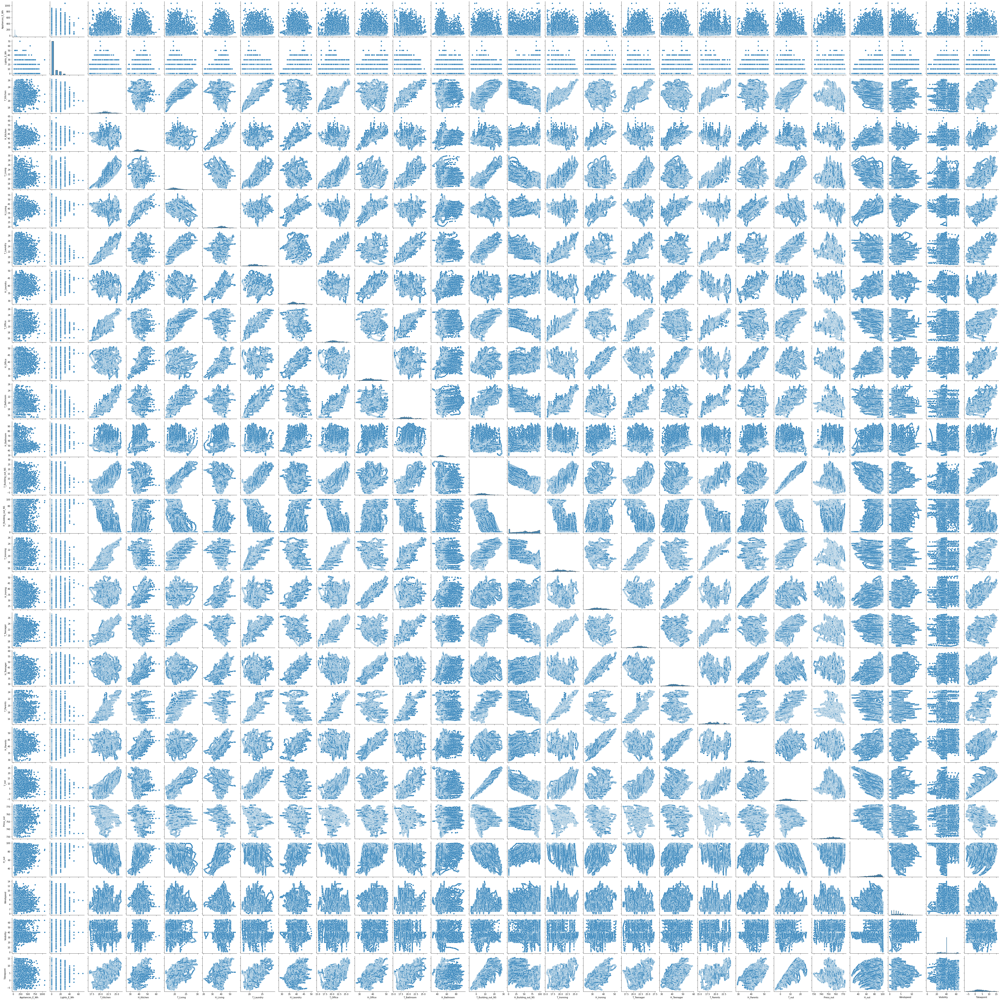

In [42]:
sns.pairplot(df);

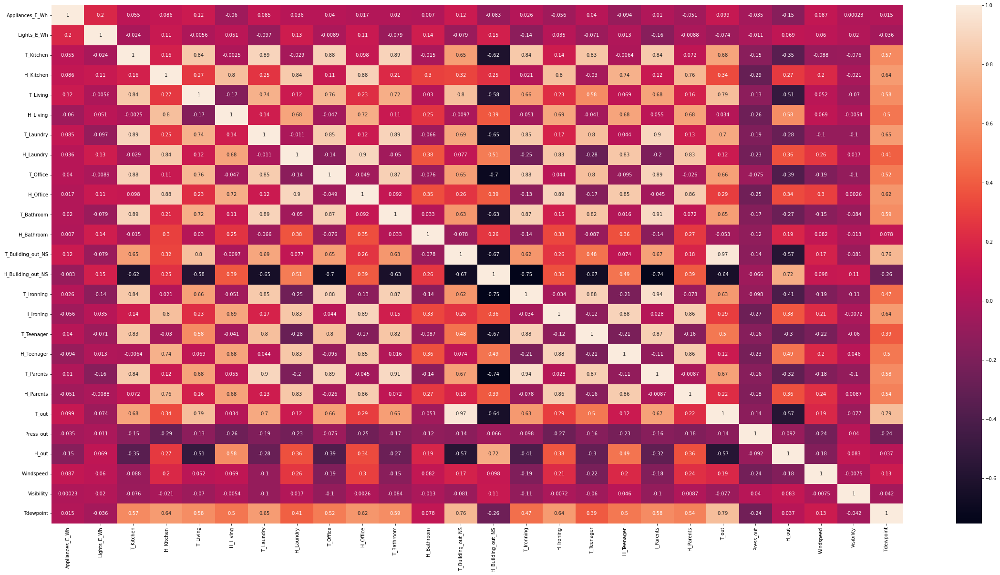

In [43]:
plt.figure(figsize=(40,20))

_ = sns.heatmap(df.corr(), annot=True);

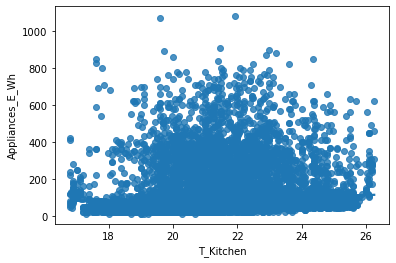

In [44]:
sns.regplot(x ='T_Kitchen', y ='Appliances_E_Wh', data = df);

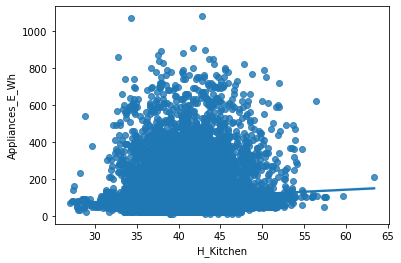

In [45]:
sns.regplot(x='H_Kitchen', y ='Appliances_E_Wh', data = df);

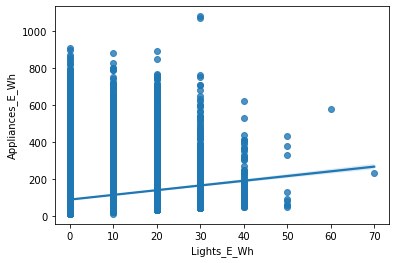

In [47]:
sns.regplot(x='Lights_E_Wh', y ='Appliances_E_Wh', data = df);

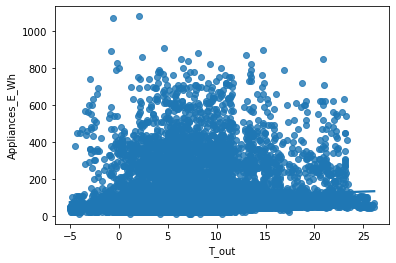

In [46]:
sns.regplot(x='T_out', y ='Appliances_E_Wh', data = df);

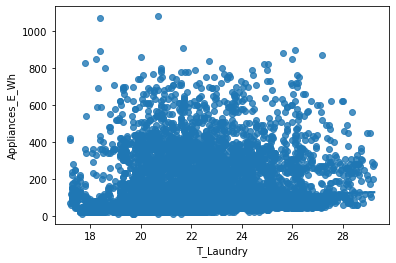

In [48]:
sns.regplot(x='T_Laundry', y ='Appliances_E_Wh', data = df);

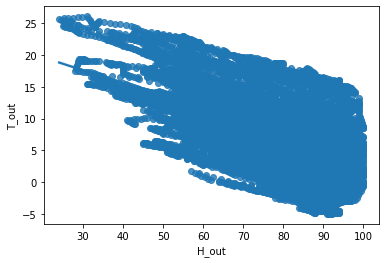

In [50]:
sns.regplot(x='H_out', y ='T_out', data = df);

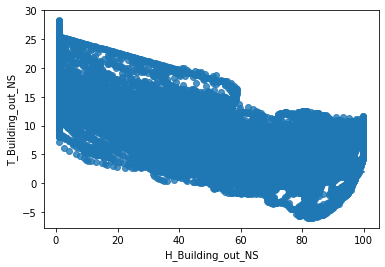

In [54]:
sns.regplot(x='H_Building_out_NS', y ='T_Building_out_NS', data = df);

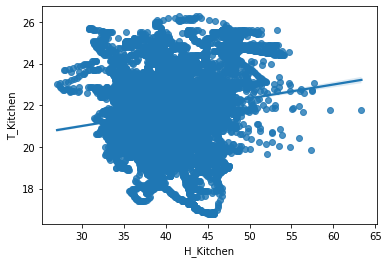

In [52]:
sns.regplot(x='H_Kitchen', y ='T_Kitchen', data = df);

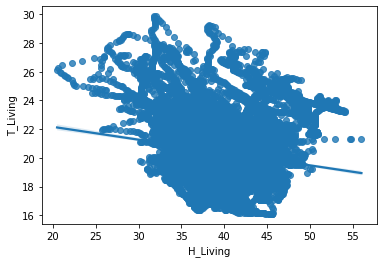

In [53]:
sns.regplot(x='H_Living', y ='T_Living', data = df);

**First Model** 

In [55]:
y = df[['Appliances_E_Wh']]

X = df.drop(["Appliances_E_Wh", "date"],axis=1)  # considering all the variables 

In [57]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.30, random_state = 123)

In [58]:
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((13814, 25), (5921, 25), (13814, 1), (5921, 1))

In [59]:
rModel1= linear_model.LinearRegression(normalize=True)

In [60]:
rModel1.fit(X_train, y_train)

LinearRegression(normalize=True)

In [61]:
rModel1.score(X_train, y_train)

0.1649378353005776

In [72]:
rModel1.coef_

array([[  2.06293218,   0.38553625,  14.98294565, -17.91664171,
        -13.60362246,  25.58214102,   4.86478715,  -4.47043835,
          0.1821234 ,  -0.08197916,   0.13549108,   6.79319696,
          0.27034137,   2.88573822,  -1.83167834,   7.20159655,
         -4.56929626, -16.0527655 ,  -0.83775707, -10.39166454,
          0.11837815,  -1.15358986,   1.56852147,   0.17510861,
          5.57543575]])

In [77]:
rModel1.intercept_

array([81.60307162])

In [62]:
y_pred = rModel1.predict(X_test)

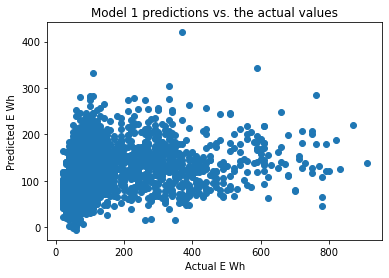

In [65]:
plt.scatter(y_test,y_pred)
plt.title("Model 1 predictions vs. the actual values")
plt.xlabel('Actual E Wh')
plt.ylabel('Predicted E Wh');

**2nd Model** 

In [66]:
X = sm.add_constant(X)

In [67]:
rModel2 = sm.OLS(y_train, X_train)

In [68]:
rModel2_results = rModel2.fit()   

In [69]:
rModel2_results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:        Appliances_E_Wh   R-squared (uncentered):                   0.563
Model:                            OLS   Adj. R-squared (uncentered):              0.563
Method:                 Least Squares   F-statistic:                              711.7
Date:                Thu, 03 Mar 2022   Prob (F-statistic):                        0.00
Time:                        08:56:39   Log-Likelihood:                         -82327.
No. Observations:               13814   AIC:                                  1.647e+05
Df Residuals:                   13789   BIC:                                  1.649e+05
Df Model:                          25                                                  
Covariance Type:            nonrobust                                                  
=====================================================================================
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
Lights_E_Wh           2.0621      0.114     18.034      0.000       1.838       2.286
T_Kitchen             0.3642      2.224      0.164      0.870      -3.996       4.724
H_Kitchen            15.0112      0.806     18.631      0.000      13.432      16.590
T_Living            -17.8694      1.961     -9.113      0.000     -21.713     -14.026
H_Living            -13.5572      0.922    -14.699      0.000     -15.365     -11.749
T_Laundry            25.6277      1.254     20.438      0.000      23.170      28.086
H_Laundry             4.9233      0.800      6.151      0.000       3.354       6.492
T_Office             -4.5429      1.219     -3.726      0.000      -6.933      -2.153
H_Office              0.1425      0.762      0.187      0.852      -1.350       1.635
T_Bathroom           -0.1694      1.392     -0.122      0.903      -2.898       2.559
H_Bathroom            0.1395      0.103      1.358      0.175      -0.062       0.341
T_Building_out_NS     6.8482      0.754      9.081      0.000       5.370       8.326
H_Building_out_NS     0.2756      0.081      3.414      0.001       0.117       0.434
T_Ironning            2.7598      1.575      1.752      0.080      -0.327       5.847
H_Ironing            -1.7791      0.510     -3.488      0.000      -2.779      -0.779
T_Teenager            7.3754      1.134      6.502      0.000       5.152       9.599
H_Teenager           -4.5767      0.446    -10.254      0.000      -5.452      -3.702
T_Parents           -15.7828      2.080     -7.587      0.000     -19.860     -11.705
H_Parents            -0.8943      0.485     -1.844      0.065      -1.845       0.057
T_out               -10.0403      1.734     -5.789      0.000     -13.440      -6.641
Press_out             0.2039      0.048      4.235      0.000       0.110       0.298
H_out                -1.0648      0.352     -3.024      0.002      -1.755      -0.375
Windspeed             1.6711      0.387      4.314      0.000       0.912       2.430
Visibility            0.1744      0.069      2.534      0.011       0.039       0.309
Tdewpoint             5.0906      1.616      3.150      0.002       1.923       8.259
==============================================================================
Omnibus:                     9752.570   Durbin-Watson:                   1.990
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           146063.708
Skew:                           3.310   Prob(JB):                         0.00
Kurtosis:                      17.489   Cond. No.                     2.90e+03
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.

In [73]:
y_pred2 = rModel2_results.predict(X_test)

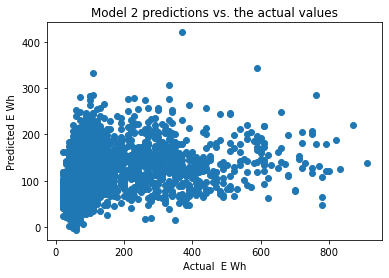

In [76]:
plt.scatter(y_test,y_pred2)
plt.title("Model 2 predictions vs. the actual values")
plt.xlabel('Actual  E Wh')
plt.ylabel('Predicted E Wh');

**Model 3**

In [90]:
y = df[['Appliances_E_Wh']]

X = df.drop(["Appliances_E_Wh", "date", "T_Kitchen", "H_Office", "T_Bathroom", "H_Bathroom", "Press_out", "Tdewpoint", "H_out"],axis=1)  # Removing the variables with large p_values

In [91]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.30, random_state = 123)

In [92]:
X = sm.add_constant(X)
rModel3 = sm.OLS(y_train, X_train)
rModel3_results = rModel3.fit() 
rModel3_results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:        Appliances_E_Wh   R-squared (uncentered):                   0.563
Model:                            OLS   Adj. R-squared (uncentered):              0.562
Method:                 Least Squares   F-statistic:                              986.1
Date:                Thu, 03 Mar 2022   Prob (F-statistic):                        0.00
Time:                        10:20:30   Log-Likelihood:                         -82338.
No. Observations:               13814   AIC:                                  1.647e+05
Df Residuals:                   13796   BIC:                                  1.648e+05
Df Model:                          18                                                  
Covariance Type:            nonrobust                                                  
=====================================================================================
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
Lights_E_Wh           2.0560      0.112     18.369      0.000       1.837       2.275
H_Kitchen            14.6613      0.677     21.668      0.000      13.335      15.988
T_Living            -16.3058      1.332    -12.238      0.000     -18.918     -13.694
H_Living            -12.6299      0.728    -17.347      0.000     -14.057     -11.203
T_Laundry            25.1746      1.117     22.532      0.000      22.985      27.365
H_Laundry             5.6617      0.703      8.048      0.000       4.283       7.041
T_Office             -4.1779      1.111     -3.761      0.000      -6.355      -2.000
T_Building_out_NS     6.8273      0.690      9.891      0.000       5.474       8.180
H_Building_out_NS     0.2022      0.070      2.896      0.004       0.065       0.339
T_Ironning            3.4526      1.492      2.313      0.021       0.527       6.378
H_Ironing            -2.1285      0.452     -4.709      0.000      -3.014      -1.243
T_Teenager            7.6189      1.061      7.180      0.000       5.539       9.699
H_Teenager           -4.5372      0.434    -10.458      0.000      -5.388      -3.687
T_Parents           -16.8069      1.830     -9.185      0.000     -20.394     -13.220
H_Parents            -0.7643      0.468     -1.631      0.103      -1.683       0.154
T_out                -5.7584      0.716     -8.047      0.000      -7.161      -4.356
Windspeed             2.0305      0.366      5.548      0.000       1.313       2.748
Visibility            0.1902      0.068      2.803      0.005       0.057       0.323
==============================================================================
Omnibus:                     9762.168   Durbin-Watson:                   1.990
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           146705.247
Skew:                           3.313   Prob(JB):                         0.00
Kurtosis:                      17.525   Cond. No.                         353.
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [94]:
y_pred3 = rModel3_results.predict(X_test)

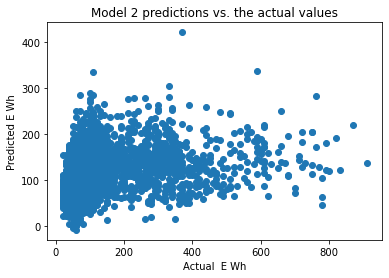

In [96]:
plt.scatter(y_test,y_pred3)
plt.title("Model 2 predictions vs. the actual values")
plt.xlabel('Actual  E Wh')
plt.ylabel('Predicted E Wh');